# Explore the dataset


In this notebook, we will perform an EDA (Exploratory Data Analysis) on the processed Waymo dataset (data in the `processed` folder). In the first part, you will create a function to display 

In [3]:
from utils import get_dataset

In [4]:
# a single file
#path = './data/waymo/training_and_validation/segment-10017090168044687777_6380_000_6400_000_with_camera_labels.tfrecord'

# all the files
path = './data/waymo/training_and_validation/*.tfrecord'

# returns a tf.data.Dataset
dataset = get_dataset(path)

INFO:tensorflow:Reading unweighted datasets: ['./data/waymo/training_and_validation/*.tfrecord']
INFO:tensorflow:Reading record datasets for input file: ['./data/waymo/training_and_validation/*.tfrecord']
INFO:tensorflow:Number of filenames to read: 97


In [50]:
dataset

<DatasetV1Adapter shapes: {image: (None, None, 3), source_id: (), key: (), filename: (), groundtruth_image_confidences: (None,), groundtruth_verified_neg_classes: (None,), groundtruth_not_exhaustive_classes: (None,), groundtruth_boxes: (None, 4), groundtruth_area: (None,), groundtruth_is_crowd: (None,), groundtruth_difficult: (None,), groundtruth_group_of: (None,), groundtruth_weights: (None,), groundtruth_classes: (None,), groundtruth_image_classes: (None,), original_image_spatial_shape: (2,)}, types: {image: tf.uint8, source_id: tf.string, key: tf.string, filename: tf.string, groundtruth_image_confidences: tf.float32, groundtruth_verified_neg_classes: tf.int64, groundtruth_not_exhaustive_classes: tf.int64, groundtruth_boxes: tf.float32, groundtruth_area: tf.float32, groundtruth_is_crowd: tf.bool, groundtruth_difficult: tf.int64, groundtruth_group_of: tf.bool, groundtruth_weights: tf.float32, groundtruth_classes: tf.int64, groundtruth_image_classes: tf.int64, original_image_spatial_sh

In [51]:
new_dataset = dataset.take(1)

In [52]:
new_dataset

<DatasetV1Adapter shapes: {image: (None, None, 3), source_id: (), key: (), filename: (), groundtruth_image_confidences: (None,), groundtruth_verified_neg_classes: (None,), groundtruth_not_exhaustive_classes: (None,), groundtruth_boxes: (None, 4), groundtruth_area: (None,), groundtruth_is_crowd: (None,), groundtruth_difficult: (None,), groundtruth_group_of: (None,), groundtruth_weights: (None,), groundtruth_classes: (None,), groundtruth_image_classes: (None,), original_image_spatial_shape: (2,)}, types: {image: tf.uint8, source_id: tf.string, key: tf.string, filename: tf.string, groundtruth_image_confidences: tf.float32, groundtruth_verified_neg_classes: tf.int64, groundtruth_not_exhaustive_classes: tf.int64, groundtruth_boxes: tf.float32, groundtruth_area: tf.float32, groundtruth_is_crowd: tf.bool, groundtruth_difficult: tf.int64, groundtruth_group_of: tf.bool, groundtruth_weights: tf.float32, groundtruth_classes: tf.int64, groundtruth_image_classes: tf.int64, original_image_spatial_sh

In [53]:
for idx, e in enumerate(new_dataset):
    print(idx, e)
    print(type(e))
    print(e.keys())    
    print(e['image'])
    print(e)

0 {'image': <tf.Tensor: shape=(640, 640, 3), dtype=uint8, numpy=
array([[[165, 192, 237],
        [163, 190, 235],
        [163, 190, 235],
        ...,
        [152, 166, 175],
        [134, 151, 159],
        [233, 250, 255]],

       [[164, 191, 236],
        [163, 190, 235],
        [163, 190, 235],
        ...,
        [177, 191, 200],
        [174, 188, 197],
        [176, 193, 201]],

       [[161, 188, 233],
        [160, 187, 232],
        [162, 189, 234],
        ...,
        [109, 123, 132],
        [130, 144, 155],
        [105, 119, 130]],

       ...,

       [[ 72,  86,  99],
        [ 72,  86,  99],
        [ 72,  86,  99],
        ...,
        [ 65,  82,  98],
        [ 65,  82,  98],
        [ 66,  83,  99]],

       [[ 71,  85,  98],
        [ 72,  86,  99],
        [ 72,  86,  99],
        ...,
        [ 78,  97, 112],
        [ 77,  96, 111],
        [ 78,  97, 112]],

       [[ 72,  86,  99],
        [ 72,  86,  99],
        [ 72,  86,  99],
        ...,
        [

In [54]:
for e in new_dataset.as_numpy_iterator():
    print(type(e))
    print(e.keys())
    print(e['groundtruth_boxes'])
    print(e['groundtruth_classes'])
    print(e['image'])    
    print(e)    

<class 'dict'>
dict_keys(['image', 'source_id', 'key', 'filename', 'groundtruth_image_confidences', 'groundtruth_verified_neg_classes', 'groundtruth_not_exhaustive_classes', 'groundtruth_boxes', 'groundtruth_area', 'groundtruth_is_crowd', 'groundtruth_difficult', 'groundtruth_group_of', 'groundtruth_weights', 'groundtruth_classes', 'groundtruth_image_classes', 'original_image_spatial_shape'])
[[0.51267344 0.3388217  0.5166209  0.34671658]
 [0.513907   0.51267344 0.5440062  0.5360291 ]
 [0.5028049  0.5144827  0.5067523  0.5210618 ]
 [0.5067523  0.5509965  0.51069975 0.5575755 ]
 [0.50625885 0.5934314  0.51119316 0.5960631 ]
 [0.5092194  0.33717695 0.51218003 0.34046647]
 [0.50477856 0.5782996  0.508726   0.58093125]
 [0.508726   0.57007575 0.52451575 0.5838918 ]
 [0.5028049  0.5815891  0.5146472  0.589484  ]
 [0.5131669  0.35428253 0.51612747 0.36415112]
 [0.5082326  0.25016886 0.5210618  0.2715508 ]
 [0.5136604  0.47665313 0.5274765  0.48915341]
 [0.51094645 0.38964498 0.54301935 0.420

## Write a function to display an image and the bounding boxes

Implement the `display_instances` function below. This function takes a batch as an input and display an image with its corresponding bounding boxes. The only requirement is that the classes should be color coded (eg, vehicles in red, pedestrians in blue, cyclist in green).

In [55]:
color_dict = {
    1 : [1, 0, 0], # vehicle
    2 : [0, 0, 1], # pedestrian
    4 : [0, 1, 0]  # cyclist
}

# color_dict = {1: 'red', 2: 'blue', 4: 'green'}


def display_instances(e, ax, row, col):
    """
    This function takes a batch from the dataset and display the image with 
    the associated bounding boxes.
    """
    # ADD CODE HERE

    img = e['image']
    width, height = e['original_image_spatial_shape']
    
    boxes = e['groundtruth_boxes']
    classes =  e['groundtruth_classes']

    ax[row, col].imshow(img)

    for j in range(len(boxes)):
        # need to scale back to original size
        # [y1,x1,y2,x2] is the correct format, https://knowledge.udacity.com/questions/687434
        y1, x1, y2, x2= boxes[j]
        x1 *= width
        x2 *= width
        y1 *= height
        y2 *= height
        
        box_class = classes[j]

        color = color_dict[box_class]       
        rect = Rectangle((x1, y1), x2 - x1, y2 - y1, edgecolor=color, facecolor='none')

        ax[row, col].add_patch(rect)

## Display 10 images 

Using the dataset created in the second cell and the function you just coded, display 10 random images with the associated bounding boxes. You can use the methods `take` and `shuffle` on the dataset.

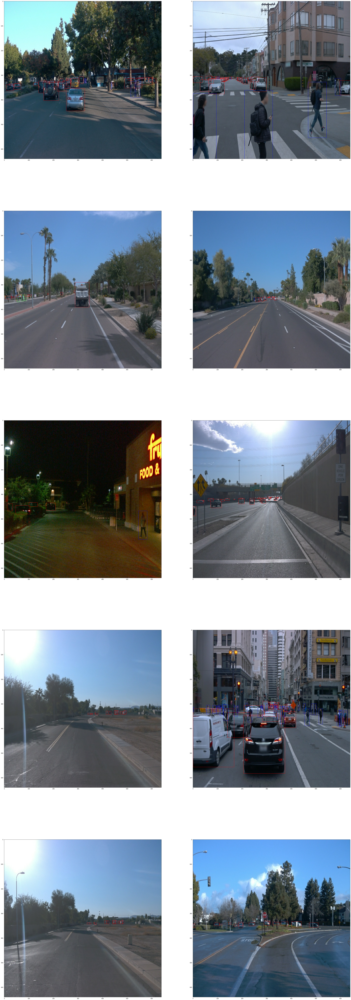

In [59]:
# STUDENT SOLUTION HERE

import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle

# To solve the issue: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
%matplotlib inline

max_row = 5
max_col = 2

f, ax = plt.subplots(max_row, max_col, figsize=(50, 150))

i = -1
for e in dataset.take(10).as_numpy_iterator():    
    i += 1
    
    row = i // max_col
    col = i % max_col   
    #print(i, row, col)

    display_instances(e, ax, row, col)
    
plt.show()

## Additional EDA

In this last part, you are free to perform any additional analysis of the dataset. What else would like to know about the data?
For example, think about data distribution. So far, you have only looked at a single file...

In [20]:
import matplotlib.pyplot as plt
import numpy as np

labels = ['Unknown', 'Vehicle', 'Pedestrian', 'Sign', 'Cyclist']        
counts = np.zeros(5, dtype=int)

frame_count = 0
for e in dataset.take(97 * 20 * 10).as_numpy_iterator():    
    frame_count += 1
    print('frame_count', frame_count)
    
    for i in e['groundtruth_classes']:
        counts[i] += 1

frame_count 1
frame_count 2
frame_count 3
frame_count 4
frame_count 5
frame_count 6
frame_count 7
frame_count 8
frame_count 9
frame_count 10
frame_count 11
frame_count 12
frame_count 13
frame_count 14
frame_count 15
frame_count 16
frame_count 17
frame_count 18
frame_count 19
frame_count 20
frame_count 21
frame_count 22
frame_count 23
frame_count 24
frame_count 25
frame_count 26
frame_count 27
frame_count 28
frame_count 29
frame_count 30
frame_count 31
frame_count 32
frame_count 33
frame_count 34
frame_count 35
frame_count 36
frame_count 37
frame_count 38
frame_count 39
frame_count 40
frame_count 41
frame_count 42
frame_count 43
frame_count 44
frame_count 45
frame_count 46
frame_count 47
frame_count 48
frame_count 49
frame_count 50
frame_count 51
frame_count 52
frame_count 53
frame_count 54
frame_count 55
frame_count 56
frame_count 57
frame_count 58
frame_count 59
frame_count 60
frame_count 61
frame_count 62
frame_count 63
frame_count 64
frame_count 65
frame_count 66
frame_count 67
fram

frame_count 581
frame_count 582
frame_count 583
frame_count 584
frame_count 585
frame_count 586
frame_count 587
frame_count 588
frame_count 589
frame_count 590
frame_count 591
frame_count 592
frame_count 593
frame_count 594
frame_count 595
frame_count 596
frame_count 597
frame_count 598
frame_count 599
frame_count 600
frame_count 601
frame_count 602
frame_count 603
frame_count 604
frame_count 605
frame_count 606
frame_count 607
frame_count 608
frame_count 609
frame_count 610
frame_count 611
frame_count 612
frame_count 613
frame_count 614
frame_count 615
frame_count 616
frame_count 617
frame_count 618
frame_count 619
frame_count 620
frame_count 621
frame_count 622
frame_count 623
frame_count 624
frame_count 625
frame_count 626
frame_count 627
frame_count 628
frame_count 629
frame_count 630
frame_count 631
frame_count 632
frame_count 633
frame_count 634
frame_count 635
frame_count 636
frame_count 637
frame_count 638
frame_count 639
frame_count 640
frame_count 641
frame_count 642
frame_co

frame_count 1132
frame_count 1133
frame_count 1134
frame_count 1135
frame_count 1136
frame_count 1137
frame_count 1138
frame_count 1139
frame_count 1140
frame_count 1141
frame_count 1142
frame_count 1143
frame_count 1144
frame_count 1145
frame_count 1146
frame_count 1147
frame_count 1148
frame_count 1149
frame_count 1150
frame_count 1151
frame_count 1152
frame_count 1153
frame_count 1154
frame_count 1155
frame_count 1156
frame_count 1157
frame_count 1158
frame_count 1159
frame_count 1160
frame_count 1161
frame_count 1162
frame_count 1163
frame_count 1164
frame_count 1165
frame_count 1166
frame_count 1167
frame_count 1168
frame_count 1169
frame_count 1170
frame_count 1171
frame_count 1172
frame_count 1173
frame_count 1174
frame_count 1175
frame_count 1176
frame_count 1177
frame_count 1178
frame_count 1179
frame_count 1180
frame_count 1181
frame_count 1182
frame_count 1183
frame_count 1184
frame_count 1185
frame_count 1186
frame_count 1187
frame_count 1188
frame_count 1189
frame_count 11

frame_count 1696
frame_count 1697
frame_count 1698
frame_count 1699
frame_count 1700
frame_count 1701
frame_count 1702
frame_count 1703
frame_count 1704
frame_count 1705
frame_count 1706
frame_count 1707
frame_count 1708
frame_count 1709
frame_count 1710
frame_count 1711
frame_count 1712
frame_count 1713
frame_count 1714
frame_count 1715
frame_count 1716
frame_count 1717
frame_count 1718
frame_count 1719
frame_count 1720
frame_count 1721
frame_count 1722
frame_count 1723
frame_count 1724
frame_count 1725
frame_count 1726
frame_count 1727
frame_count 1728
frame_count 1729
frame_count 1730
frame_count 1731
frame_count 1732
frame_count 1733
frame_count 1734
frame_count 1735
frame_count 1736
frame_count 1737
frame_count 1738
frame_count 1739
frame_count 1740
frame_count 1741
frame_count 1742
frame_count 1743
frame_count 1744
frame_count 1745
frame_count 1746
frame_count 1747
frame_count 1748
frame_count 1749
frame_count 1750
frame_count 1751
frame_count 1752
frame_count 1753
frame_count 17

frame_count 2254
frame_count 2255
frame_count 2256
frame_count 2257
frame_count 2258
frame_count 2259
frame_count 2260
frame_count 2261
frame_count 2262
frame_count 2263
frame_count 2264
frame_count 2265
frame_count 2266
frame_count 2267
frame_count 2268
frame_count 2269
frame_count 2270
frame_count 2271
frame_count 2272
frame_count 2273
frame_count 2274
frame_count 2275
frame_count 2276
frame_count 2277
frame_count 2278
frame_count 2279
frame_count 2280
frame_count 2281
frame_count 2282
frame_count 2283
frame_count 2284
frame_count 2285
frame_count 2286
frame_count 2287
frame_count 2288
frame_count 2289
frame_count 2290
frame_count 2291
frame_count 2292
frame_count 2293
frame_count 2294
frame_count 2295
frame_count 2296
frame_count 2297
frame_count 2298
frame_count 2299
frame_count 2300
frame_count 2301
frame_count 2302
frame_count 2303
frame_count 2304
frame_count 2305
frame_count 2306
frame_count 2307
frame_count 2308
frame_count 2309
frame_count 2310
frame_count 2311
frame_count 23

frame_count 2830
frame_count 2831
frame_count 2832
frame_count 2833
frame_count 2834
frame_count 2835
frame_count 2836
frame_count 2837
frame_count 2838
frame_count 2839
frame_count 2840
frame_count 2841
frame_count 2842
frame_count 2843
frame_count 2844
frame_count 2845
frame_count 2846
frame_count 2847
frame_count 2848
frame_count 2849
frame_count 2850
frame_count 2851
frame_count 2852
frame_count 2853
frame_count 2854
frame_count 2855
frame_count 2856
frame_count 2857
frame_count 2858
frame_count 2859
frame_count 2860
frame_count 2861
frame_count 2862
frame_count 2863
frame_count 2864
frame_count 2865
frame_count 2866
frame_count 2867
frame_count 2868
frame_count 2869
frame_count 2870
frame_count 2871
frame_count 2872
frame_count 2873
frame_count 2874
frame_count 2875
frame_count 2876
frame_count 2877
frame_count 2878
frame_count 2879
frame_count 2880
frame_count 2881
frame_count 2882
frame_count 2883
frame_count 2884
frame_count 2885
frame_count 2886
frame_count 2887
frame_count 28

frame_count 3386
frame_count 3387
frame_count 3388
frame_count 3389
frame_count 3390
frame_count 3391
frame_count 3392
frame_count 3393
frame_count 3394
frame_count 3395
frame_count 3396
frame_count 3397
frame_count 3398
frame_count 3399
frame_count 3400
frame_count 3401
frame_count 3402
frame_count 3403
frame_count 3404
frame_count 3405
frame_count 3406
frame_count 3407
frame_count 3408
frame_count 3409
frame_count 3410
frame_count 3411
frame_count 3412
frame_count 3413
frame_count 3414
frame_count 3415
frame_count 3416
frame_count 3417
frame_count 3418
frame_count 3419
frame_count 3420
frame_count 3421
frame_count 3422
frame_count 3423
frame_count 3424
frame_count 3425
frame_count 3426
frame_count 3427
frame_count 3428
frame_count 3429
frame_count 3430
frame_count 3431
frame_count 3432
frame_count 3433
frame_count 3434
frame_count 3435
frame_count 3436
frame_count 3437
frame_count 3438
frame_count 3439
frame_count 3440
frame_count 3441
frame_count 3442
frame_count 3443
frame_count 34

frame_count 3936
frame_count 3937
frame_count 3938
frame_count 3939
frame_count 3940
frame_count 3941
frame_count 3942
frame_count 3943
frame_count 3944
frame_count 3945
frame_count 3946
frame_count 3947
frame_count 3948
frame_count 3949
frame_count 3950
frame_count 3951
frame_count 3952
frame_count 3953
frame_count 3954
frame_count 3955
frame_count 3956
frame_count 3957
frame_count 3958
frame_count 3959
frame_count 3960
frame_count 3961
frame_count 3962
frame_count 3963
frame_count 3964
frame_count 3965
frame_count 3966
frame_count 3967
frame_count 3968
frame_count 3969
frame_count 3970
frame_count 3971
frame_count 3972
frame_count 3973
frame_count 3974
frame_count 3975
frame_count 3976
frame_count 3977
frame_count 3978
frame_count 3979
frame_count 3980
frame_count 3981
frame_count 3982
frame_count 3983
frame_count 3984
frame_count 3985
frame_count 3986
frame_count 3987
frame_count 3988
frame_count 3989
frame_count 3990
frame_count 3991
frame_count 3992
frame_count 3993
frame_count 39

frame_count 4425
frame_count 4426
frame_count 4427
frame_count 4428
frame_count 4429
frame_count 4430
frame_count 4431
frame_count 4432
frame_count 4433
frame_count 4434
frame_count 4435
frame_count 4436
frame_count 4437
frame_count 4438
frame_count 4439
frame_count 4440
frame_count 4441
frame_count 4442
frame_count 4443
frame_count 4444
frame_count 4445
frame_count 4446
frame_count 4447
frame_count 4448
frame_count 4449
frame_count 4450
frame_count 4451
frame_count 4452
frame_count 4453
frame_count 4454
frame_count 4455
frame_count 4456
frame_count 4457
frame_count 4458
frame_count 4459
frame_count 4460
frame_count 4461
frame_count 4462
frame_count 4463
frame_count 4464
frame_count 4465
frame_count 4466
frame_count 4467
frame_count 4468
frame_count 4469
frame_count 4470
frame_count 4471
frame_count 4472
frame_count 4473
frame_count 4474
frame_count 4475
frame_count 4476
frame_count 4477
frame_count 4478
frame_count 4479
frame_count 4480
frame_count 4481
frame_count 4482
frame_count 44

frame_count 4986
frame_count 4987
frame_count 4988
frame_count 4989
frame_count 4990
frame_count 4991
frame_count 4992
frame_count 4993
frame_count 4994
frame_count 4995
frame_count 4996
frame_count 4997
frame_count 4998
frame_count 4999
frame_count 5000
frame_count 5001
frame_count 5002
frame_count 5003
frame_count 5004
frame_count 5005
frame_count 5006
frame_count 5007
frame_count 5008
frame_count 5009
frame_count 5010
frame_count 5011
frame_count 5012
frame_count 5013
frame_count 5014
frame_count 5015
frame_count 5016
frame_count 5017
frame_count 5018
frame_count 5019
frame_count 5020
frame_count 5021
frame_count 5022
frame_count 5023
frame_count 5024
frame_count 5025
frame_count 5026
frame_count 5027
frame_count 5028
frame_count 5029
frame_count 5030
frame_count 5031
frame_count 5032
frame_count 5033
frame_count 5034
frame_count 5035
frame_count 5036
frame_count 5037
frame_count 5038
frame_count 5039
frame_count 5040
frame_count 5041
frame_count 5042
frame_count 5043
frame_count 50

frame_count 5553
frame_count 5554
frame_count 5555
frame_count 5556
frame_count 5557
frame_count 5558
frame_count 5559
frame_count 5560
frame_count 5561
frame_count 5562
frame_count 5563
frame_count 5564
frame_count 5565
frame_count 5566
frame_count 5567
frame_count 5568
frame_count 5569
frame_count 5570
frame_count 5571
frame_count 5572
frame_count 5573
frame_count 5574
frame_count 5575
frame_count 5576
frame_count 5577
frame_count 5578
frame_count 5579
frame_count 5580
frame_count 5581
frame_count 5582
frame_count 5583
frame_count 5584
frame_count 5585
frame_count 5586
frame_count 5587
frame_count 5588
frame_count 5589
frame_count 5590
frame_count 5591
frame_count 5592
frame_count 5593
frame_count 5594
frame_count 5595
frame_count 5596
frame_count 5597
frame_count 5598
frame_count 5599
frame_count 5600
frame_count 5601
frame_count 5602
frame_count 5603
frame_count 5604
frame_count 5605
frame_count 5606
frame_count 5607
frame_count 5608
frame_count 5609
frame_count 5610
frame_count 56

frame_count 6124
frame_count 6125
frame_count 6126
frame_count 6127
frame_count 6128
frame_count 6129
frame_count 6130
frame_count 6131
frame_count 6132
frame_count 6133
frame_count 6134
frame_count 6135
frame_count 6136
frame_count 6137
frame_count 6138
frame_count 6139
frame_count 6140
frame_count 6141
frame_count 6142
frame_count 6143
frame_count 6144
frame_count 6145
frame_count 6146
frame_count 6147
frame_count 6148
frame_count 6149
frame_count 6150
frame_count 6151
frame_count 6152
frame_count 6153
frame_count 6154
frame_count 6155
frame_count 6156
frame_count 6157
frame_count 6158
frame_count 6159
frame_count 6160
frame_count 6161
frame_count 6162
frame_count 6163
frame_count 6164
frame_count 6165
frame_count 6166
frame_count 6167
frame_count 6168
frame_count 6169
frame_count 6170
frame_count 6171
frame_count 6172
frame_count 6173
frame_count 6174
frame_count 6175
frame_count 6176
frame_count 6177
frame_count 6178
frame_count 6179
frame_count 6180
frame_count 6181
frame_count 61

frame_count 6689
frame_count 6690
frame_count 6691
frame_count 6692
frame_count 6693
frame_count 6694
frame_count 6695
frame_count 6696
frame_count 6697
frame_count 6698
frame_count 6699
frame_count 6700
frame_count 6701
frame_count 6702
frame_count 6703
frame_count 6704
frame_count 6705
frame_count 6706
frame_count 6707
frame_count 6708
frame_count 6709
frame_count 6710
frame_count 6711
frame_count 6712
frame_count 6713
frame_count 6714
frame_count 6715
frame_count 6716
frame_count 6717
frame_count 6718
frame_count 6719
frame_count 6720
frame_count 6721
frame_count 6722
frame_count 6723
frame_count 6724
frame_count 6725
frame_count 6726
frame_count 6727
frame_count 6728
frame_count 6729
frame_count 6730
frame_count 6731
frame_count 6732
frame_count 6733
frame_count 6734
frame_count 6735
frame_count 6736
frame_count 6737
frame_count 6738
frame_count 6739
frame_count 6740
frame_count 6741
frame_count 6742
frame_count 6743
frame_count 6744
frame_count 6745
frame_count 6746
frame_count 67

frame_count 7269
frame_count 7270
frame_count 7271
frame_count 7272
frame_count 7273
frame_count 7274
frame_count 7275
frame_count 7276
frame_count 7277
frame_count 7278
frame_count 7279
frame_count 7280
frame_count 7281
frame_count 7282
frame_count 7283
frame_count 7284
frame_count 7285
frame_count 7286
frame_count 7287
frame_count 7288
frame_count 7289
frame_count 7290
frame_count 7291
frame_count 7292
frame_count 7293
frame_count 7294
frame_count 7295
frame_count 7296
frame_count 7297
frame_count 7298
frame_count 7299
frame_count 7300
frame_count 7301
frame_count 7302
frame_count 7303
frame_count 7304
frame_count 7305
frame_count 7306
frame_count 7307
frame_count 7308
frame_count 7309
frame_count 7310
frame_count 7311
frame_count 7312
frame_count 7313
frame_count 7314
frame_count 7315
frame_count 7316
frame_count 7317
frame_count 7318
frame_count 7319
frame_count 7320
frame_count 7321
frame_count 7322
frame_count 7323
frame_count 7324
frame_count 7325
frame_count 7326
frame_count 73

frame_count 7781
frame_count 7782
frame_count 7783
frame_count 7784
frame_count 7785
frame_count 7786
frame_count 7787
frame_count 7788
frame_count 7789
frame_count 7790
frame_count 7791
frame_count 7792
frame_count 7793
frame_count 7794
frame_count 7795
frame_count 7796
frame_count 7797
frame_count 7798
frame_count 7799
frame_count 7800
frame_count 7801
frame_count 7802
frame_count 7803
frame_count 7804
frame_count 7805
frame_count 7806
frame_count 7807
frame_count 7808
frame_count 7809
frame_count 7810
frame_count 7811
frame_count 7812
frame_count 7813
frame_count 7814
frame_count 7815
frame_count 7816
frame_count 7817
frame_count 7818
frame_count 7819
frame_count 7820
frame_count 7821
frame_count 7822
frame_count 7823
frame_count 7824
frame_count 7825
frame_count 7826
frame_count 7827
frame_count 7828
frame_count 7829
frame_count 7830
frame_count 7831
frame_count 7832
frame_count 7833
frame_count 7834
frame_count 7835
frame_count 7836
frame_count 7837
frame_count 7838
frame_count 78

frame_count 8297
frame_count 8298
frame_count 8299
frame_count 8300
frame_count 8301
frame_count 8302
frame_count 8303
frame_count 8304
frame_count 8305
frame_count 8306
frame_count 8307
frame_count 8308
frame_count 8309
frame_count 8310
frame_count 8311
frame_count 8312
frame_count 8313
frame_count 8314
frame_count 8315
frame_count 8316
frame_count 8317
frame_count 8318
frame_count 8319
frame_count 8320
frame_count 8321
frame_count 8322
frame_count 8323
frame_count 8324
frame_count 8325
frame_count 8326
frame_count 8327
frame_count 8328
frame_count 8329
frame_count 8330
frame_count 8331
frame_count 8332
frame_count 8333
frame_count 8334
frame_count 8335
frame_count 8336
frame_count 8337
frame_count 8338
frame_count 8339
frame_count 8340
frame_count 8341
frame_count 8342
frame_count 8343
frame_count 8344
frame_count 8345
frame_count 8346
frame_count 8347
frame_count 8348
frame_count 8349
frame_count 8350
frame_count 8351
frame_count 8352
frame_count 8353
frame_count 8354
frame_count 83

frame_count 8839
frame_count 8840
frame_count 8841
frame_count 8842
frame_count 8843
frame_count 8844
frame_count 8845
frame_count 8846
frame_count 8847
frame_count 8848
frame_count 8849
frame_count 8850
frame_count 8851
frame_count 8852
frame_count 8853
frame_count 8854
frame_count 8855
frame_count 8856
frame_count 8857
frame_count 8858
frame_count 8859
frame_count 8860
frame_count 8861
frame_count 8862
frame_count 8863
frame_count 8864
frame_count 8865
frame_count 8866
frame_count 8867
frame_count 8868
frame_count 8869
frame_count 8870
frame_count 8871
frame_count 8872
frame_count 8873
frame_count 8874
frame_count 8875
frame_count 8876
frame_count 8877
frame_count 8878
frame_count 8879
frame_count 8880
frame_count 8881
frame_count 8882
frame_count 8883
frame_count 8884
frame_count 8885
frame_count 8886
frame_count 8887
frame_count 8888
frame_count 8889
frame_count 8890
frame_count 8891
frame_count 8892
frame_count 8893
frame_count 8894
frame_count 8895
frame_count 8896
frame_count 88

frame_count 9404
frame_count 9405
frame_count 9406
frame_count 9407
frame_count 9408
frame_count 9409
frame_count 9410
frame_count 9411
frame_count 9412
frame_count 9413
frame_count 9414
frame_count 9415
frame_count 9416
frame_count 9417
frame_count 9418
frame_count 9419
frame_count 9420
frame_count 9421
frame_count 9422
frame_count 9423
frame_count 9424
frame_count 9425
frame_count 9426
frame_count 9427
frame_count 9428
frame_count 9429
frame_count 9430
frame_count 9431
frame_count 9432
frame_count 9433
frame_count 9434
frame_count 9435
frame_count 9436
frame_count 9437
frame_count 9438
frame_count 9439
frame_count 9440
frame_count 9441
frame_count 9442
frame_count 9443
frame_count 9444
frame_count 9445
frame_count 9446
frame_count 9447
frame_count 9448
frame_count 9449
frame_count 9450
frame_count 9451
frame_count 9452
frame_count 9453
frame_count 9454
frame_count 9455
frame_count 9456
frame_count 9457
frame_count 9458
frame_count 9459
frame_count 9460
frame_count 9461
frame_count 94

frame_count 9888
frame_count 9889
frame_count 9890
frame_count 9891
frame_count 9892
frame_count 9893
frame_count 9894
frame_count 9895
frame_count 9896
frame_count 9897
frame_count 9898
frame_count 9899
frame_count 9900
frame_count 9901
frame_count 9902
frame_count 9903
frame_count 9904
frame_count 9905
frame_count 9906
frame_count 9907
frame_count 9908
frame_count 9909
frame_count 9910
frame_count 9911
frame_count 9912
frame_count 9913
frame_count 9914
frame_count 9915
frame_count 9916
frame_count 9917
frame_count 9918
frame_count 9919
frame_count 9920
frame_count 9921
frame_count 9922
frame_count 9923
frame_count 9924
frame_count 9925
frame_count 9926
frame_count 9927
frame_count 9928
frame_count 9929
frame_count 9930
frame_count 9931
frame_count 9932
frame_count 9933
frame_count 9934
frame_count 9935
frame_count 9936
frame_count 9937
frame_count 9938
frame_count 9939
frame_count 9940
frame_count 9941
frame_count 9942
frame_count 9943
frame_count 9944
frame_count 9945
frame_count 99

frame_count 10356
frame_count 10357
frame_count 10358
frame_count 10359
frame_count 10360
frame_count 10361
frame_count 10362
frame_count 10363
frame_count 10364
frame_count 10365
frame_count 10366
frame_count 10367
frame_count 10368
frame_count 10369
frame_count 10370
frame_count 10371
frame_count 10372
frame_count 10373
frame_count 10374
frame_count 10375
frame_count 10376
frame_count 10377
frame_count 10378
frame_count 10379
frame_count 10380
frame_count 10381
frame_count 10382
frame_count 10383
frame_count 10384
frame_count 10385
frame_count 10386
frame_count 10387
frame_count 10388
frame_count 10389
frame_count 10390
frame_count 10391
frame_count 10392
frame_count 10393
frame_count 10394
frame_count 10395
frame_count 10396
frame_count 10397
frame_count 10398
frame_count 10399
frame_count 10400
frame_count 10401
frame_count 10402
frame_count 10403
frame_count 10404
frame_count 10405
frame_count 10406
frame_count 10407
frame_count 10408
frame_count 10409
frame_count 10410
frame_coun

frame_count 10850
frame_count 10851
frame_count 10852
frame_count 10853
frame_count 10854
frame_count 10855
frame_count 10856
frame_count 10857
frame_count 10858
frame_count 10859
frame_count 10860
frame_count 10861
frame_count 10862
frame_count 10863
frame_count 10864
frame_count 10865
frame_count 10866
frame_count 10867
frame_count 10868
frame_count 10869
frame_count 10870
frame_count 10871
frame_count 10872
frame_count 10873
frame_count 10874
frame_count 10875
frame_count 10876
frame_count 10877
frame_count 10878
frame_count 10879
frame_count 10880
frame_count 10881
frame_count 10882
frame_count 10883
frame_count 10884
frame_count 10885
frame_count 10886
frame_count 10887
frame_count 10888
frame_count 10889
frame_count 10890
frame_count 10891
frame_count 10892
frame_count 10893
frame_count 10894
frame_count 10895
frame_count 10896
frame_count 10897
frame_count 10898
frame_count 10899
frame_count 10900
frame_count 10901
frame_count 10902
frame_count 10903
frame_count 10904
frame_coun

frame_count 11311
frame_count 11312
frame_count 11313
frame_count 11314
frame_count 11315
frame_count 11316
frame_count 11317
frame_count 11318
frame_count 11319
frame_count 11320
frame_count 11321
frame_count 11322
frame_count 11323
frame_count 11324
frame_count 11325
frame_count 11326
frame_count 11327
frame_count 11328
frame_count 11329
frame_count 11330
frame_count 11331
frame_count 11332
frame_count 11333
frame_count 11334
frame_count 11335
frame_count 11336
frame_count 11337
frame_count 11338
frame_count 11339
frame_count 11340
frame_count 11341
frame_count 11342
frame_count 11343
frame_count 11344
frame_count 11345
frame_count 11346
frame_count 11347
frame_count 11348
frame_count 11349
frame_count 11350
frame_count 11351
frame_count 11352
frame_count 11353
frame_count 11354
frame_count 11355
frame_count 11356
frame_count 11357
frame_count 11358
frame_count 11359
frame_count 11360
frame_count 11361
frame_count 11362
frame_count 11363
frame_count 11364
frame_count 11365
frame_coun

frame_count 11772
frame_count 11773
frame_count 11774
frame_count 11775
frame_count 11776
frame_count 11777
frame_count 11778
frame_count 11779
frame_count 11780
frame_count 11781
frame_count 11782
frame_count 11783
frame_count 11784
frame_count 11785
frame_count 11786
frame_count 11787
frame_count 11788
frame_count 11789
frame_count 11790
frame_count 11791
frame_count 11792
frame_count 11793
frame_count 11794
frame_count 11795
frame_count 11796
frame_count 11797
frame_count 11798
frame_count 11799
frame_count 11800
frame_count 11801
frame_count 11802
frame_count 11803
frame_count 11804
frame_count 11805
frame_count 11806
frame_count 11807
frame_count 11808
frame_count 11809
frame_count 11810
frame_count 11811
frame_count 11812
frame_count 11813
frame_count 11814
frame_count 11815
frame_count 11816
frame_count 11817
frame_count 11818
frame_count 11819
frame_count 11820
frame_count 11821
frame_count 11822
frame_count 11823
frame_count 11824
frame_count 11825
frame_count 11826
frame_coun

frame_count 12258
frame_count 12259
frame_count 12260
frame_count 12261
frame_count 12262
frame_count 12263
frame_count 12264
frame_count 12265
frame_count 12266
frame_count 12267
frame_count 12268
frame_count 12269
frame_count 12270
frame_count 12271
frame_count 12272
frame_count 12273
frame_count 12274
frame_count 12275
frame_count 12276
frame_count 12277
frame_count 12278
frame_count 12279
frame_count 12280
frame_count 12281
frame_count 12282
frame_count 12283
frame_count 12284
frame_count 12285
frame_count 12286
frame_count 12287
frame_count 12288
frame_count 12289
frame_count 12290
frame_count 12291
frame_count 12292
frame_count 12293
frame_count 12294
frame_count 12295
frame_count 12296
frame_count 12297
frame_count 12298
frame_count 12299
frame_count 12300
frame_count 12301
frame_count 12302
frame_count 12303
frame_count 12304
frame_count 12305
frame_count 12306
frame_count 12307
frame_count 12308
frame_count 12309
frame_count 12310
frame_count 12311
frame_count 12312
frame_coun

frame_count 12741
frame_count 12742
frame_count 12743
frame_count 12744
frame_count 12745
frame_count 12746
frame_count 12747
frame_count 12748
frame_count 12749
frame_count 12750
frame_count 12751
frame_count 12752
frame_count 12753
frame_count 12754
frame_count 12755
frame_count 12756
frame_count 12757
frame_count 12758
frame_count 12759
frame_count 12760
frame_count 12761
frame_count 12762
frame_count 12763
frame_count 12764
frame_count 12765
frame_count 12766
frame_count 12767
frame_count 12768
frame_count 12769
frame_count 12770
frame_count 12771
frame_count 12772
frame_count 12773
frame_count 12774
frame_count 12775
frame_count 12776
frame_count 12777
frame_count 12778
frame_count 12779
frame_count 12780
frame_count 12781
frame_count 12782
frame_count 12783
frame_count 12784
frame_count 12785
frame_count 12786
frame_count 12787
frame_count 12788
frame_count 12789
frame_count 12790
frame_count 12791
frame_count 12792
frame_count 12793
frame_count 12794
frame_count 12795
frame_coun

frame_count 13223
frame_count 13224
frame_count 13225
frame_count 13226
frame_count 13227
frame_count 13228
frame_count 13229
frame_count 13230
frame_count 13231
frame_count 13232
frame_count 13233
frame_count 13234
frame_count 13235
frame_count 13236
frame_count 13237
frame_count 13238
frame_count 13239
frame_count 13240
frame_count 13241
frame_count 13242
frame_count 13243
frame_count 13244
frame_count 13245
frame_count 13246
frame_count 13247
frame_count 13248
frame_count 13249
frame_count 13250
frame_count 13251
frame_count 13252
frame_count 13253
frame_count 13254
frame_count 13255
frame_count 13256
frame_count 13257
frame_count 13258
frame_count 13259
frame_count 13260
frame_count 13261
frame_count 13262
frame_count 13263
frame_count 13264
frame_count 13265
frame_count 13266
frame_count 13267
frame_count 13268
frame_count 13269
frame_count 13270
frame_count 13271
frame_count 13272
frame_count 13273
frame_count 13274
frame_count 13275
frame_count 13276
frame_count 13277
frame_coun

frame_count 13705
frame_count 13706
frame_count 13707
frame_count 13708
frame_count 13709
frame_count 13710
frame_count 13711
frame_count 13712
frame_count 13713
frame_count 13714
frame_count 13715
frame_count 13716
frame_count 13717
frame_count 13718
frame_count 13719
frame_count 13720
frame_count 13721
frame_count 13722
frame_count 13723
frame_count 13724
frame_count 13725
frame_count 13726
frame_count 13727
frame_count 13728
frame_count 13729
frame_count 13730
frame_count 13731
frame_count 13732
frame_count 13733
frame_count 13734
frame_count 13735
frame_count 13736
frame_count 13737
frame_count 13738
frame_count 13739
frame_count 13740
frame_count 13741
frame_count 13742
frame_count 13743
frame_count 13744
frame_count 13745
frame_count 13746
frame_count 13747
frame_count 13748
frame_count 13749
frame_count 13750
frame_count 13751
frame_count 13752
frame_count 13753
frame_count 13754
frame_count 13755
frame_count 13756
frame_count 13757
frame_count 13758
frame_count 13759
frame_coun

frame_count 14189
frame_count 14190
frame_count 14191
frame_count 14192
frame_count 14193
frame_count 14194
frame_count 14195
frame_count 14196
frame_count 14197
frame_count 14198
frame_count 14199
frame_count 14200
frame_count 14201
frame_count 14202
frame_count 14203
frame_count 14204
frame_count 14205
frame_count 14206
frame_count 14207
frame_count 14208
frame_count 14209
frame_count 14210
frame_count 14211
frame_count 14212
frame_count 14213
frame_count 14214
frame_count 14215
frame_count 14216
frame_count 14217
frame_count 14218
frame_count 14219
frame_count 14220
frame_count 14221
frame_count 14222
frame_count 14223
frame_count 14224
frame_count 14225
frame_count 14226
frame_count 14227
frame_count 14228
frame_count 14229
frame_count 14230
frame_count 14231
frame_count 14232
frame_count 14233
frame_count 14234
frame_count 14235
frame_count 14236
frame_count 14237
frame_count 14238
frame_count 14239
frame_count 14240
frame_count 14241
frame_count 14242
frame_count 14243
frame_coun

frame_count 14667
frame_count 14668
frame_count 14669
frame_count 14670
frame_count 14671
frame_count 14672
frame_count 14673
frame_count 14674
frame_count 14675
frame_count 14676
frame_count 14677
frame_count 14678
frame_count 14679
frame_count 14680
frame_count 14681
frame_count 14682
frame_count 14683
frame_count 14684
frame_count 14685
frame_count 14686
frame_count 14687
frame_count 14688
frame_count 14689
frame_count 14690
frame_count 14691
frame_count 14692
frame_count 14693
frame_count 14694
frame_count 14695
frame_count 14696
frame_count 14697
frame_count 14698
frame_count 14699
frame_count 14700
frame_count 14701
frame_count 14702
frame_count 14703
frame_count 14704
frame_count 14705
frame_count 14706
frame_count 14707
frame_count 14708
frame_count 14709
frame_count 14710
frame_count 14711
frame_count 14712
frame_count 14713
frame_count 14714
frame_count 14715
frame_count 14716
frame_count 14717
frame_count 14718
frame_count 14719
frame_count 14720
frame_count 14721
frame_coun

frame_count 15154
frame_count 15155
frame_count 15156
frame_count 15157
frame_count 15158
frame_count 15159
frame_count 15160
frame_count 15161
frame_count 15162
frame_count 15163
frame_count 15164
frame_count 15165
frame_count 15166
frame_count 15167
frame_count 15168
frame_count 15169
frame_count 15170
frame_count 15171
frame_count 15172
frame_count 15173
frame_count 15174
frame_count 15175
frame_count 15176
frame_count 15177
frame_count 15178
frame_count 15179
frame_count 15180
frame_count 15181
frame_count 15182
frame_count 15183
frame_count 15184
frame_count 15185
frame_count 15186
frame_count 15187
frame_count 15188
frame_count 15189
frame_count 15190
frame_count 15191
frame_count 15192
frame_count 15193
frame_count 15194
frame_count 15195
frame_count 15196
frame_count 15197
frame_count 15198
frame_count 15199
frame_count 15200
frame_count 15201
frame_count 15202
frame_count 15203
frame_count 15204
frame_count 15205
frame_count 15206
frame_count 15207
frame_count 15208
frame_coun

frame_count 15630
frame_count 15631
frame_count 15632
frame_count 15633
frame_count 15634
frame_count 15635
frame_count 15636
frame_count 15637
frame_count 15638
frame_count 15639
frame_count 15640
frame_count 15641
frame_count 15642
frame_count 15643
frame_count 15644
frame_count 15645
frame_count 15646
frame_count 15647
frame_count 15648
frame_count 15649
frame_count 15650
frame_count 15651
frame_count 15652
frame_count 15653
frame_count 15654
frame_count 15655
frame_count 15656
frame_count 15657
frame_count 15658
frame_count 15659
frame_count 15660
frame_count 15661
frame_count 15662
frame_count 15663
frame_count 15664
frame_count 15665
frame_count 15666
frame_count 15667
frame_count 15668
frame_count 15669
frame_count 15670
frame_count 15671
frame_count 15672
frame_count 15673
frame_count 15674
frame_count 15675
frame_count 15676
frame_count 15677
frame_count 15678
frame_count 15679
frame_count 15680
frame_count 15681
frame_count 15682
frame_count 15683
frame_count 15684
frame_coun

frame_count 16176
frame_count 16177
frame_count 16178
frame_count 16179
frame_count 16180
frame_count 16181
frame_count 16182
frame_count 16183
frame_count 16184
frame_count 16185
frame_count 16186
frame_count 16187
frame_count 16188
frame_count 16189
frame_count 16190
frame_count 16191
frame_count 16192
frame_count 16193
frame_count 16194
frame_count 16195
frame_count 16196
frame_count 16197
frame_count 16198
frame_count 16199
frame_count 16200
frame_count 16201
frame_count 16202
frame_count 16203
frame_count 16204
frame_count 16205
frame_count 16206
frame_count 16207
frame_count 16208
frame_count 16209
frame_count 16210
frame_count 16211
frame_count 16212
frame_count 16213
frame_count 16214
frame_count 16215
frame_count 16216
frame_count 16217
frame_count 16218
frame_count 16219
frame_count 16220
frame_count 16221
frame_count 16222
frame_count 16223
frame_count 16224
frame_count 16225
frame_count 16226
frame_count 16227
frame_count 16228
frame_count 16229
frame_count 16230
frame_coun

frame_count 16662
frame_count 16663
frame_count 16664
frame_count 16665
frame_count 16666
frame_count 16667
frame_count 16668
frame_count 16669
frame_count 16670
frame_count 16671
frame_count 16672
frame_count 16673
frame_count 16674
frame_count 16675
frame_count 16676
frame_count 16677
frame_count 16678
frame_count 16679
frame_count 16680
frame_count 16681
frame_count 16682
frame_count 16683
frame_count 16684
frame_count 16685
frame_count 16686
frame_count 16687
frame_count 16688
frame_count 16689
frame_count 16690
frame_count 16691
frame_count 16692
frame_count 16693
frame_count 16694
frame_count 16695
frame_count 16696
frame_count 16697
frame_count 16698
frame_count 16699
frame_count 16700
frame_count 16701
frame_count 16702
frame_count 16703
frame_count 16704
frame_count 16705
frame_count 16706
frame_count 16707
frame_count 16708
frame_count 16709
frame_count 16710
frame_count 16711
frame_count 16712
frame_count 16713
frame_count 16714
frame_count 16715
frame_count 16716
frame_coun

frame_count 17154
frame_count 17155
frame_count 17156
frame_count 17157
frame_count 17158
frame_count 17159
frame_count 17160
frame_count 17161
frame_count 17162
frame_count 17163
frame_count 17164
frame_count 17165
frame_count 17166
frame_count 17167
frame_count 17168
frame_count 17169
frame_count 17170
frame_count 17171
frame_count 17172
frame_count 17173
frame_count 17174
frame_count 17175
frame_count 17176
frame_count 17177
frame_count 17178
frame_count 17179
frame_count 17180
frame_count 17181
frame_count 17182
frame_count 17183
frame_count 17184
frame_count 17185
frame_count 17186
frame_count 17187
frame_count 17188
frame_count 17189
frame_count 17190
frame_count 17191
frame_count 17192
frame_count 17193
frame_count 17194
frame_count 17195
frame_count 17196
frame_count 17197
frame_count 17198
frame_count 17199
frame_count 17200
frame_count 17201
frame_count 17202
frame_count 17203
frame_count 17204
frame_count 17205
frame_count 17206
frame_count 17207
frame_count 17208
frame_coun

frame_count 17619
frame_count 17620
frame_count 17621
frame_count 17622
frame_count 17623
frame_count 17624
frame_count 17625
frame_count 17626
frame_count 17627
frame_count 17628
frame_count 17629
frame_count 17630
frame_count 17631
frame_count 17632
frame_count 17633
frame_count 17634
frame_count 17635
frame_count 17636
frame_count 17637
frame_count 17638
frame_count 17639
frame_count 17640
frame_count 17641
frame_count 17642
frame_count 17643
frame_count 17644
frame_count 17645
frame_count 17646
frame_count 17647
frame_count 17648
frame_count 17649
frame_count 17650
frame_count 17651
frame_count 17652
frame_count 17653
frame_count 17654
frame_count 17655
frame_count 17656
frame_count 17657
frame_count 17658
frame_count 17659
frame_count 17660
frame_count 17661
frame_count 17662
frame_count 17663
frame_count 17664
frame_count 17665
frame_count 17666
frame_count 17667
frame_count 17668
frame_count 17669
frame_count 17670
frame_count 17671
frame_count 17672
frame_count 17673
frame_coun

frame_count 18103
frame_count 18104
frame_count 18105
frame_count 18106
frame_count 18107
frame_count 18108
frame_count 18109
frame_count 18110
frame_count 18111
frame_count 18112
frame_count 18113
frame_count 18114
frame_count 18115
frame_count 18116
frame_count 18117
frame_count 18118
frame_count 18119
frame_count 18120
frame_count 18121
frame_count 18122
frame_count 18123
frame_count 18124
frame_count 18125
frame_count 18126
frame_count 18127
frame_count 18128
frame_count 18129
frame_count 18130
frame_count 18131
frame_count 18132
frame_count 18133
frame_count 18134
frame_count 18135
frame_count 18136
frame_count 18137
frame_count 18138
frame_count 18139
frame_count 18140
frame_count 18141
frame_count 18142
frame_count 18143
frame_count 18144
frame_count 18145
frame_count 18146
frame_count 18147
frame_count 18148
frame_count 18149
frame_count 18150
frame_count 18151
frame_count 18152
frame_count 18153
frame_count 18154
frame_count 18155
frame_count 18156
frame_count 18157
frame_coun

frame_count 18585
frame_count 18586
frame_count 18587
frame_count 18588
frame_count 18589
frame_count 18590
frame_count 18591
frame_count 18592
frame_count 18593
frame_count 18594
frame_count 18595
frame_count 18596
frame_count 18597
frame_count 18598
frame_count 18599
frame_count 18600
frame_count 18601
frame_count 18602
frame_count 18603
frame_count 18604
frame_count 18605
frame_count 18606
frame_count 18607
frame_count 18608
frame_count 18609
frame_count 18610
frame_count 18611
frame_count 18612
frame_count 18613
frame_count 18614
frame_count 18615
frame_count 18616
frame_count 18617
frame_count 18618
frame_count 18619
frame_count 18620
frame_count 18621
frame_count 18622
frame_count 18623
frame_count 18624
frame_count 18625
frame_count 18626
frame_count 18627
frame_count 18628
frame_count 18629
frame_count 18630
frame_count 18631
frame_count 18632
frame_count 18633
frame_count 18634
frame_count 18635
frame_count 18636
frame_count 18637
frame_count 18638
frame_count 18639
frame_coun

frame_count 19069
frame_count 19070
frame_count 19071
frame_count 19072
frame_count 19073
frame_count 19074
frame_count 19075
frame_count 19076
frame_count 19077
frame_count 19078
frame_count 19079
frame_count 19080
frame_count 19081
frame_count 19082
frame_count 19083
frame_count 19084
frame_count 19085
frame_count 19086
frame_count 19087
frame_count 19088
frame_count 19089
frame_count 19090
frame_count 19091
frame_count 19092
frame_count 19093
frame_count 19094
frame_count 19095
frame_count 19096
frame_count 19097
frame_count 19098
frame_count 19099
frame_count 19100
frame_count 19101
frame_count 19102
frame_count 19103
frame_count 19104
frame_count 19105
frame_count 19106
frame_count 19107
frame_count 19108
frame_count 19109
frame_count 19110
frame_count 19111
frame_count 19112
frame_count 19113
frame_count 19114
frame_count 19115
frame_count 19116
frame_count 19117
frame_count 19118
frame_count 19119
frame_count 19120
frame_count 19121
frame_count 19122
frame_count 19123
frame_coun

total_count 454951
labels ['Unknown', 'Vehicle', 'Pedestrian', 'Sign', 'Cyclist']
counts [     0 348286 103958      0   2707]
ratios [0.         0.76554618 0.22850373 0.         0.00595009]


Text(0.5, 1.0, 'class distribution')

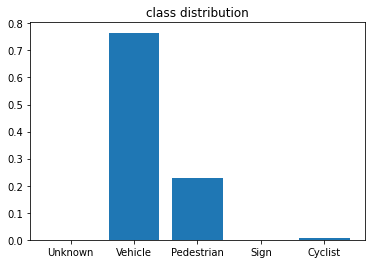

In [21]:
total_count = np.sum(counts)
ratios = counts / np.sum(counts)

print('total_count', total_count)
print('labels', labels)
print('counts', counts)
print('ratios', ratios)
      
%matplotlib inline
plt.bar(np.arange(5), ratios, tick_label=labels)
plt.title('class distribution')